# BLIP TESTING

This file is used to visualize the captions of the fine tuned Blip models over a particular set of cards. Not only that, but it was also used to extract the simple desriptive captions that a vanilla BLIP model would create given the Dixit images.

In [1]:
from transformers import BlipProcessor, BlipForConditionalGeneration
from PIL import Image
import torch
from collections import defaultdict
import matplotlib.pyplot as plt
import os
import json

C:\Users\stefa\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.8_qbz5n2kfra8p0\LocalCache\local-packages\Python38\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
path_to_weights = "../weights/rephrased_blip(2nd)/epoch50.pt"

processor = BlipProcessor.from_pretrained("Salesforce/blip-image-captioning-base")
model = BlipForConditionalGeneration.from_pretrained("Salesforce/blip-image-captioning-base").to("cuda")

if path_to_weights:
    model.load_state_dict(torch.load(path_to_weights))

C:\Users\stefa\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.8_qbz5n2kfra8p0\LocalCache\local-packages\Python38\site-packages\torch\_utils.py:776: UserWarning: TypedStorage is deprecated. It will be removed in the future and UntypedStorage will be the only storage class. This should only matter to you if you are using storages directly.  To access UntypedStorage directly, use tensor.untyped_storage() instead of tensor.storage()
  return self.fget.__get__(instance, owner)()


In [3]:
def get_cards(path):
    images = dict()
    for image in os.listdir(path):
        raw_image = Image.open(os.path.join(path, image)).convert("RGB")
        raw_image = raw_image.resize((224, 224))
        images[image] = raw_image

    return images

In [4]:
def generate_captions(model, images, processor, num_captions = 1):
    model.eval()
    dictionary = defaultdict(list)
    for image_index, raw_image in images.items():
        inputs = processor(raw_image, return_tensors="pt").to("cuda")
        
        captions = []
        for _ in range(num_captions):

            caption_ids = model.generate(
                **inputs,
                max_length=50,  
                num_return_sequences=1,
                do_sample=True, 
                top_k=50,       
                top_p=0.95,     
                temperature=0.7, 
                repetition_penalty=1.2, 
                no_repeat_ngram_size=3  
            )

            caption = processor.decode(caption_ids[0], skip_special_tokens=True)
            captions.append(caption)

        dictionary[image_index].extend(captions)
        #print(captions)

    return dictionary

In [5]:
def show_images_and_captions(dictionary, path):
    for image_name, captions in dictionary.items():
        raw_image = Image.open(os.path.join(path, image_name)).convert("RGB")
        plt.imshow(raw_image)
        plt.title("\n".join(captions))
        plt.show()

In [6]:
def generate_and_show(path, model, processor, save_to_json = False, n_captions = 10):
    images = get_cards(path)
    dictionary = generate_captions(model, images, processor, num_captions= n_captions)
    show_images_and_captions(dictionary, path)

    if save_to_json:
        path_to_save = ""
        with open(path_to_save, "w") as outfile: 
            json.dump(dictionary, outfile)

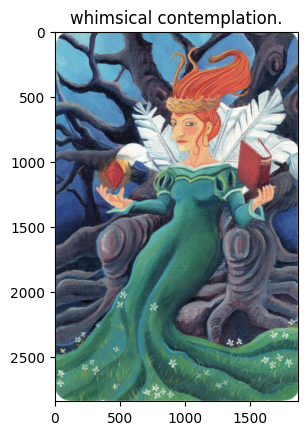

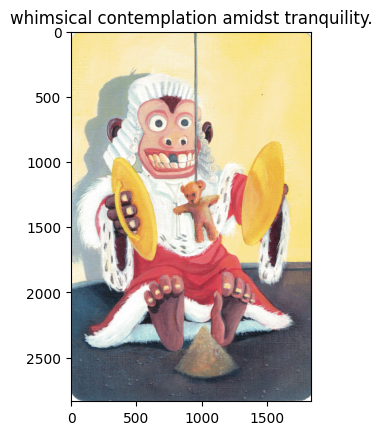

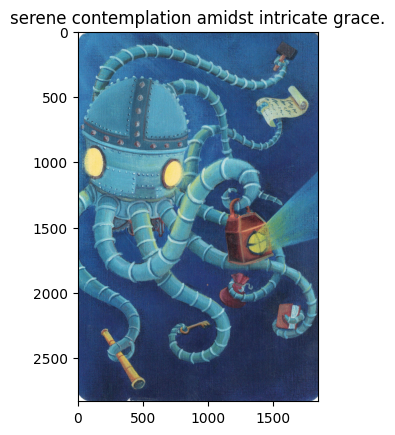

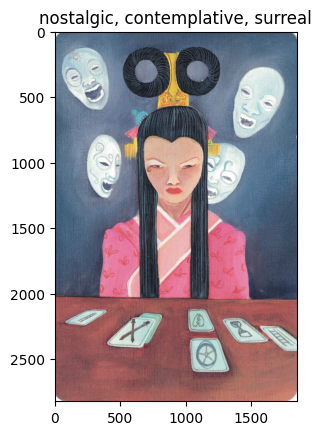

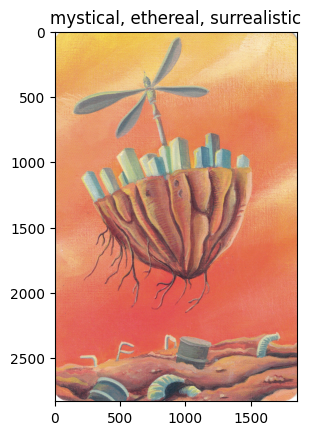

...

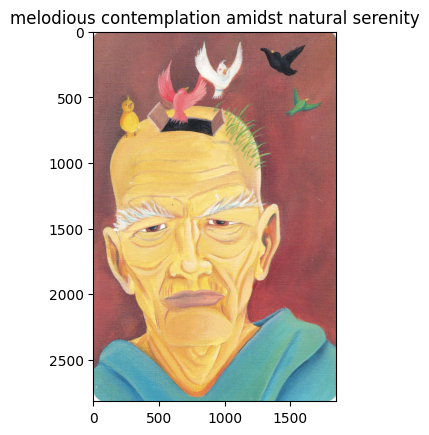

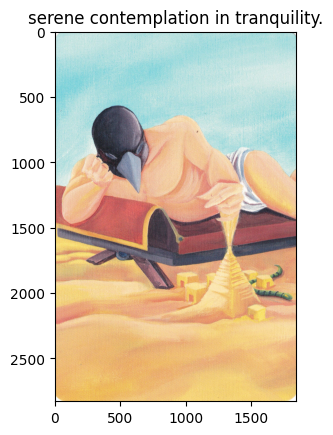

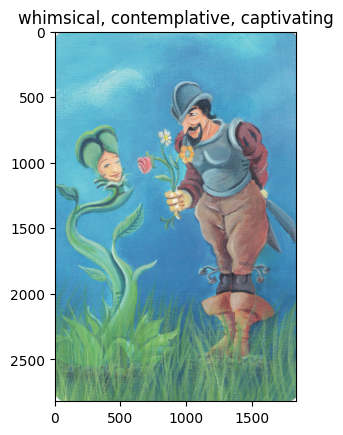

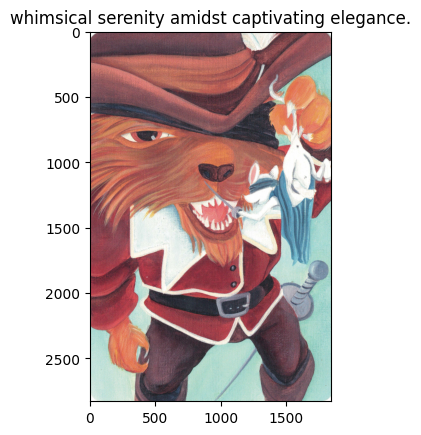

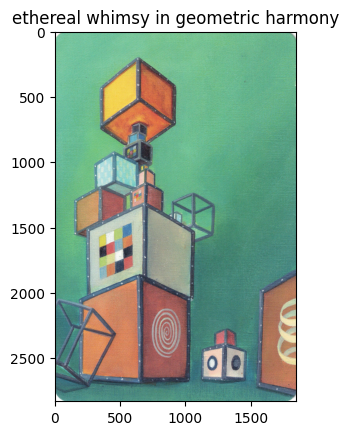

In [7]:
generate_and_show("../cards/odissey_cards", model, processor, n_captions = 1)